<a href="https://www.netsuite.com/portal/home.shtml"><img src="https://i.imgur.com/5hHcHwD.jpg" width=400> </a>
<h1 align=center><font size = 5>Solving Receipt Image Dataset</font>
<h1 align=center><font size = 5>Prepared by: NetSuite Machine Learning Program</font>

This is a sample notebook to start the solution for the receipt image dataset. This dataset and the problem is quite unique. This notebook will demo some beginning steps for you to get started. Sections include:
1. Data Import
2. Data Understanding
3. Data Processing

The path provided in this notebook is to use Tesseract python library to extract text from pictures. It gives you a head start and sample code on how to access the data and how to start the problem. At the end, we give you some idea on what to do next. Feel free to use it as the starting point of the team brainstorm.

Remember, the goal for everyone here is to learn and have fun with Machine learning!

# 0. Import Libraries

In [223]:
#importing libraries for the sample code only.

import pytesseract
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random as rand
import pandas as pd
from csv import reader
from os import path as p
import datetime
from datetime import datetime
from dateutil.parser import parse
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import KMeans
import re
from pytesseract import Output
import datefinder
from datetime import datetime
from sklearn.model_selection import train_test_split
    

# 1. Data Import

In [5]:
import NMLDataAccess as NML

accessKey = os.environ.get('S3_ACCESS_KEY')
secretKey = os.environ.get('S3_SECRET_KEY')

In [6]:
# gain access of the images and their IDs
images = NML.image_data_access(accessKey, secretKey, 'hackathon-2020', 'hackathon/HackathonImageDataset.zip','HackathonImageDataset.zip')

In [7]:
# gain access of the label (total amount) of the images with their IDs 
labels = NML.csv_data_access(accessKey, secretKey,
                  'hackathon-2020','hackathon/HackathonImageDatasetLabel.csv')

# 2. Data Understanding

In [8]:
# image data comes in as a list of lists.
images[986]

['X51009568881.jpg',
 <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=884x1678 at 0x7F0088C1C748>]

In [9]:
print("There are " + str(len(images)) + " images in total")

There are 987 images in total


In [221]:
#first elemenet of the list is the image id, second element is the actual image 
print(images[0][1])
#images[0][1]

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=463x1013 at 0x7F00886F0DD8>


In [11]:
#Labels file includes the image name and their total amount.
labels.head(10)

,id,total
0,X00016469670.jpg,193.00
1,X00016469671.jpg,170.00
2,X51005200931.jpg,436.20
3,X51005230605.jpg,4.90
4,X51005230616.jpg,38.90
5,X51005230621.jpg,7.30
6,X51005230648.jpg,6.35
7,X51005230657.jpg,7.95
8,X51005230659.jpg,8.00
9,X51005268275.jpg,278.80


# 3. Data Processing 

We can use the tesseract library to transform image into text. The library is pre-installed. Initate it with the below code.

In [12]:
#This line to set the tesseract directory. Make sure this line is included for using tesseract library.
pytesseract.pytesseract.tesseract_cmd = r'/usr/bin/tesseract'

In [13]:
#sample code to use tesseract to transform the above receipt to text

imgstr = pytesseract.image_to_string(images[0][1], lang='eng')
imgstr.strip()

'tan woon yann\n\nBOOK TA -K (TAMAN DAYA) SDN BHD\nPBONT-W\nNO.5? $5,57 & 59, JALAN SAGU 18,\nTAMAN DAYA\n81100 JOHOR BAHRU.\nJOHOR.\n\nLAM MITA A\n\nDocument Ho : TDO1167104\n\n \n\n \n\nDate 25/12/2018 8:13:39 PM\nCashier MANIS\nMember\nCASH BILL\nCODE/DESC PRICE Dise AMOUNT\nQuy RM RM\n9556929040118 AF MODELLING CLAY KIDDY FISH\n1PC + 9.00) 0,00 9.00\nTotal : 9,00\nRour ding Adjustment 0.00\nRound. :d Total (RM): 9.00\nCash oy 40.00.\nCHANGE 00\n\n  \n\nGOODS SOLD ARE NOT RETURNAP\nEXCHANGEABLE\n\n \n\nTHANK YOU\nPLEASE COME AGAIN t'

##### *IMPORTANT NOTE:  A loop to transform all images into text will take 30-50 min. For starter, we recommand to use one member's notebook doing the task while use another member's notebook to do smaller batch data for testing and developing. Good thing about being on cloud is without manually shutting down the kernel, the variables will be saved if browser is closed. You do not need to run the code again to continue working on where you left.* 

##### *Once done, you can save the processed list/dataframe to a csv. For any reason you close the kernel, all you need is to read that file instead of re-processing it for another 40 min.* 

# 4. Next Steps

The hardest part of this dataset is problem definition. The labels provided are numeric values, is this a regression problem? Should you turn this into a classification problem or even a reinforcement learning problem? You might need to create multiple stages, combining rules and ML to accomplish this. There is no right answer but make sure you think through what you want to achieve so that your process and solution is logical. 

Now you have the starting steps of turning images into text, this changes from an image recognition problem to a natural language processing problem. You can use the NLTK or spacy (NLP python libraries) to process the text and build a prediction models for identifying the total amount of the receipt - bag of words, sentiment embeddings, entity recognition or any other ways you feel reasonable - maybe just a heuristic model to find the biggest numeric value from the text using regular expression. 

Another piece you can think about is image processing. We used tesseract directly on the original image. Are the results good? Does the text outputed have the correct total amount in the string? Are there ways to make this process better and more accurate? 

If you do not like using Tesseract, feel free to try out any other methods out there to solve the problem. Machine learning is challenging, especially when you are not so experienced. Google is a great tool to find directions. Research and find what you need to do, determine how to do it, and just code it! This environment has lots of libraries pre-installed. If you want to use any additional python library, try import it directly. If it is not installed already, simply type in "!pip install -packagename" and restart the noteboook(kernel). You will have access to it.

Do not forget to leave a portion of the data for testing and remember to not include the testing data in training - that is what we called leakage. Lastly, what will the metrics be and how do you measure it?


# The-Nearest-Netsuiters hackaton roadmap
## Problem Statements:

### 1) Apply OCR using Pytesseract on images to find the total value spent and the date on which the amount was spent per receipt. 
### 2) Apply ML Algorithms like Linear Regression, Logistic Regression, Kmeans Clustering to get the insights out of the data gathered from Task 1.



In [14]:
# Find individual Characters from an image and make a data frame out of it. 
# def characterRecognition(image_name):
#     img = cv2.imread('/home/jovyan/Elie_Code/instructions_nws/train_images/'+image_name)
#     #img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
#     data =[]
#     #Detecting Characters 
#     hImg,wImg,_ = img.shape
#     boxes = pytesseract.image_to_boxes(img)
#     for b in boxes.splitlines():
#         #print(b)
#         b = b.split(' ')
#         #print(b)
#         data.append(b)
#         x,y,w,h=int(b[1]),int(b[2]),int(b[3]),int(b[4])
#         cv2.rectangle(img,(x,hImg-y),(w,hImg-h),(0,0,255),1)
#         cv2.putText(img,b[0],(x,hImg-y+40),cv2.FONT_HERSHEY_COMPLEX,1,(50,50,255),2)
#     print(data)
#     df = pd.DataFrame(data,columns=['label','X','Y','W','H','NoIdea'])
#     print(df)    
#     return df

# # file_name = 'HackathonImageDataset.zip'
# # fimages = []
# # with NML.ZipFile(file_name) as archive:
# #     for entry in archive.infolist():
# #         with archive.open(entry) as file:
# #             fimg = NML.Image.open(file)
# #             fimages.append([entry.filename, fimg]) 
# #print(df) print(df.head(10))

[['t', '75', '958', '87', '981', '0'], ['a', '89', '958', '105', '976', '0'], ['n', '109', '958', '126', '976', '0'], ['w', '138', '958', '159', '976', '0'], ['o', '159', '958', '166', '976', '0'], ['o', '176', '958', '187', '976', '0'], ['n', '192', '958', '223', '976', '0'], ['y', '241', '950', '253', '976', '0'], ['a', '261', '958', '272', '976', '0'], ['n', '281', '958', '292', '976', '0'], ['n', '302', '958', '319', '976', '0'], ['B', '73', '903', '80', '916', '0'], ['O', '85', '903', '92', '916', '0'], ['O', '92', '903', '98', '916', '0'], ['K', '104', '903', '122', '916', '0'], ['T', '132', '903', '140', '916', '0'], ['A', '144', '903', '155', '916', '0'], ['K', '162', '903', '178', '916', '0'], ['(', '186', '901', '192', '918', '0'], ['T', '195', '904', '204', '917', '0'], ['A', '205', '904', '216', '917', '0'], ['M', '220', '904', '230', '917', '0'], ['A', '236', '904', '240', '912', '0'], ['N', '242', '904', '258', '917', '0'], ['D', '269', '904', '276', '917', '0'], ['A', '2

In [15]:
pip install datefinder

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


# Data Preperation
1) Create a function to identify the word Total from an image.

2) Create a function to identify the word Date from an image.

3) Grab values of Total and Date from the cropped images and make a data frame out of it. 

4) Apply useful Machine Learning to get the values from Cropped Images. Here we have used LSTM using custom config option.


In [228]:
# Data Preperation
# 1) Create a function to identify the word Total from an image.
# 2) Create a function to identify the word Date from an image.
# 3) Grab values of Total and Date from the cropped images and make a data frame out of it. 
# 4) Apply useful Machine Learning to get the values from Cropped Images. Here we have used LSTM using custom config option.


##### Crop the image which has just the word Total using regular expression from an Image.
# The wordTotalRecognition is going through each image from the data set given above and crop the exact section of the image
# which includes the word Total and save that cropped image in a seperate file so we can apply pytesseract inbuilt function
# with custom config using LSTM algo to identify the Values for every total amount.

def wordTotalRecognition(image_name,generated_names):
    #if( not p.exists('/home/jovyan/Elie_Code/instructions_nws/CroppedImages/'+image_name)):
        print(image_name)
        img = cv2.imread('/home/jovyan/Elie_Code/instructions_nws/train_images/'+image_name)
        img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
        data =[]
        hImg,wImg,_ = img.shape
        boxes = pytesseract.image_to_data(img,output_type=Output.DICT)
        keys = list(boxes.keys())
        total_regex = re.compile(r'(total)')
        for i in range(len(boxes['text'])):
            if total_regex.search(boxes['text'][i].lower()): 
                (x, y, w, h) = (boxes['left'][i], boxes['top'][i], boxes['width'][i], boxes['height'][i])
                path = '/home/jovyan/Elie_Code/instructions_nws/CroppedImages'
                cv2.imwrite(os.path.join(path , image_name),img[y-6:y+h+25,x:20+x+wImg+w+25])
                if image_name not in generated_names:
                    generated_names.append(image_name)
        return generated_names

# Using Custom Config option --oem 1 ( LSTM Algorithm to identify "Total" words correctly using imread function from an image)
def lineTotalRecognition(image, data):
    custom_config= r'--oem 1 --psm 6'
    img = cv2.imread('/home/jovyan/Elie_Code/instructions_nws/CroppedImages/'+image)
    imgstr = pytesseract.image_to_string(img,config=custom_config,lang='eng')
    #print(imgstr)
    list_words = []
    list_words = imgstr.splitlines()
    for word in list_words:
        total_regex = re.compile(r'(total)')
        if total_regex.search(word.lower()): 
            words = word.split(' ')
            numbers=[]
            for word in words:
                x = re.findall('([0-9]+?(.)[0-9]+)', word)
                #print("------- inside words",x)
                if x:
                    s = list(x[0])
                    numbers.append(s[0])
                    break
            numbers.append(image)
            data.append(numbers)
    
    return data

###### Crop the image which has just the word Date using regular expression from an Image.

# The wordDateRecognition is going through each image from the data set given above and crop the exact section of the image
# which includes the word Date and save that cropped image in a seperate file so we can apply pytesseract inbuilt function
# with custom config using LSTM algo to identify the Values for every Date.

def wordDateRecognition(image_name,generated_names):
    #if(not p.exists('/home/jovyan/Elie_Code/instructions_nws/CroppedImages/dates/'+image_name)):
        print(image_name)
        img = cv2.imread('/home/jovyan/Elie_Code/instructions_nws/train_images/'+image_name)
        img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
        data =[]
        #Detecting  word totoal and amount logic
        hImg,wImg,_ = img.shape
        boxes = pytesseract.image_to_data(img,output_type=Output.DICT)
        keys = list(boxes.keys())
        #[1-9] |1[0-9]| 2[0-9]|3[0-1]
        #date_pattern = '^([0-9][0-9]|[12][0-9]|3[0-1])(/|.|-)(0[1-9]|1[012])(/|-)(19|20)\d\d$'
        date_pattern ='^(0[1-9]|1[0-2]|[12][0-9]|3[01])(/|-)(0[1-9]|1[0-2]|1[0-9]|[12][0-9]|3[01])(/|-)((19|20)|(19|20)\d\d)$'
        n_boxes = len(boxes['text'])
        path = '/home/jovyan/Elie_Code/instructions_nws/CroppedImages/dates'
        for i in range(n_boxes):
                #print( boxes['text'][i])
                if re.match(date_pattern, boxes['text'][i]):
                    #print("inside the pattern matching", boxes['text'][i])

                    (x, y, w, h) = (boxes['left'][i], boxes['top'][i], boxes['width'][i], boxes['height'][i])
                    #img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)              
                    cv2.imwrite(os.path.join(path , image_name),img[y-6:y+h+5,x:20+x+wImg+w+25])
                    if image_name not in generated_names:
                        generated_names.append(image_name)

        #print(generated_names)
        return generated_names

# Using Custom Config option --oem 1 ( LSTM Algorithm to identify "Date" Words correctly using imread function from an image)
def lineDateRecognition(image,data):
    custom_config= r'--oem 1 --psm 6'
    img = cv2.imread('/home/jovyan/Elie_Code/instructions_nws/CroppedImages/dates/'+image)
    imgstr = pytesseract.image_to_string(img)#,config=custom_config)
    #print(imgstr)
    list_words = []
    list_words = imgstr.splitlines()
    for word in list_words:
            words = word.split(' ')
            #print("-----***",words)
            final_date=[]
            #words.append(image)
            final_date.append(words[0])
            final_date.append(image)
            data.append(final_date)
            #data.append(words[len(words)-1])
    
    return data
      
# Helper function to apply inner join on two data frames
def inner_joinTwoDataFrames(total_df, date_df):
    merged_inner = pd.merge(left=total_df, right=date_df, left_on='FileName', right_on='FileName')
    print(merged_inner)
    return merged_inner

# Helper function to apply Outer join on two data frames
def left_joinTwoDataFrames(total_df,date_df):
    merged_left = pd.merge(left=total_df, right=date_df, how='left', left_on='FileName', right_on='FileName')
    print(merged_left)
    return merged_left    

In [227]:
names_total=[]
generated_names_total =[]
for i in range(len(images)):
    names_total = wordTotalRecognition(images[i][0],generated_names_total) #Pass the name of an image

-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-
-


In [27]:
#print(names_total)
data_total = []    
for i in range(len(names_total)):
    #print(i)
    totaldf = lineTotalRecognition(names_total[i],data_total) #Pass the name of a cropped image.

In [41]:
print(len(names_total))
total_dataFrame = pd.DataFrame(totaldf, columns=['Amount', 'FileName'])
print(total_dataFrame)

6
               Amount          FileName
0                9.60  X00016469612.jpg
1               60.31  X00016469619.jpg
2               33.90  X00016469620.jpg
3               80.91  X00016469622.jpg
4               31.00  X00016469669.jpg
..                ...               ...
846              0.90  X51009447842.jpg
847               101  X51009453729.jpg
848  X51009453801.jpg              None
849  X51009453804.jpg              None
850              9.84  X51009568881.jpg

[851 rows x 2 columns]


In [42]:
#Just for Printing purpose 
# for i in range(len(totaldf)):
#     print(totaldf[i])

# total_dataFrame = pd.DataFrame(totaldf, columns=['Amount', 'FileName'])
# print(total_dataFrame)
    
print("Date section starts *********--------------------------") 
names_date = []
generated_names_date =[]
for i in range(len(images)):
    names_date = wordDateRecognition(images[i][0],generated_names_date) # Pass the list to store the generated names


Date section starts *********--------------------------
X00016469612.jpg
X00016469619.jpg
X00016469620.jpg
X00016469622.jpg
X00016469623.jpg
X00016469669.jpg
X00016469670.jpg
X00016469671.jpg
X00016469672.jpg
X00016469676.jpg
X51005200931.jpg
X51005200938.jpg
X51005230605.jpg
X51005230616.jpg
X51005230617.jpg
X51005230621.jpg
X51005230648.jpg
X51005230657.jpg
X51005230659.jpg
X51005255805.jpg
X51005268200.jpg
X51005268262.jpg
X51005268275.jpg
X51005268400.jpg
X51005268408.jpg
X51005268472.jpg
X51005288570.jpg
X51005301659.jpg
X51005301661.jpg
X51005301666.jpg
X51005301667.jpg
X51005303661.jpg
X51005306399.jpg
X51005337867.jpg
X51005337872.jpg
X51005337877.jpg
X51005361883.jpg
X51005361895.jpg
X51005361897.jpg
X51005361898.jpg
X51005361900.jpg
X51005361906.jpg
X51005361907.jpg
X51005361908.jpg
X51005361912.jpg
X51005361923.jpg
X51005361946.jpg
X51005361950.jpg
X51005365179.jpg
X51005365187.jpg
X51005433492.jpg
X51005433494.jpg
X51005433514.jpg
X51005433518.jpg
X51005433522.jpg
X51005433

In [44]:
date_df=[]
data_date = []    
for i in range(len(names_date)):
    date_df = lineDateRecognition(names_date[i],data_date)


date_dataFrame = pd.DataFrame(date_df, columns=['Date', 'FileName'])

print(date_dataFrame)


['X00016469612.jpg', 'X00016469619.jpg', 'X00016469620.jpg', 'X00016469622.jpg', 'X00016469669.jpg', 'X00016469670.jpg', 'X00016469671.jpg', 'X00016469672.jpg', 'X00016469676.jpg', 'X51005230605.jpg', 'X51005230616.jpg', 'X51005230617.jpg', 'X51005230621.jpg', 'X51005230648.jpg', 'X51005230657.jpg', 'X51005230659.jpg', 'X51005255805.jpg', 'X51005268200.jpg', 'X51005268262.jpg', 'X51005268275.jpg', 'X51005268400.jpg', 'X51005301659.jpg', 'X51005301661.jpg', 'X51005301666.jpg', 'X51005301667.jpg', 'X51005303661.jpg', 'X51005337872.jpg', 'X51005337877.jpg', 'X51005361883.jpg', 'X51005361895.jpg', 'X51005361897.jpg', 'X51005361898.jpg', 'X51005361900.jpg', 'X51005361907.jpg', 'X51005361908.jpg', 'X51005361912.jpg', 'X51005365187.jpg', 'X51005433533.jpg', 'X51005433552.jpg', 'X51005433556.jpg', 'X51005441398.jpg', 'X51005441401.jpg', 'X51005441402.jpg', 'X51005441408.jpg', 'X51005442341.jpg', 'X51005442343.jpg', 'X51005442344.jpg', 'X51005442346.jpg', 'X51005442366.jpg', 'X51005442378.jpg',

In [218]:
# Merge two data frames with the Total and Date as two different colunmns.

final_dataframeInner = inner_joinTwoDataFrames(total_dataFrame,date_dataFrame)
final_dataframeInner['Month'] = None
for index, row in final_dataframeInner.iterrows():
    try:
        row['Month'] = parse(row['Date']).month
        row['Month'] = row['Month'].astype(float)
        #print(row['Month'])
    except:
        pass
            
print(final_dataframeInner)

    Amount          FileName        Date
0     9.60  X00016469612.jpg  25/12/2018
1    60.31  X00016469619.jpg  19/10/2018
2    33.90  X00016469620.jpg    12-01-19
3    31.00  X00016469669.jpg  09/01/2019
4      193  X00016469670.jpg  15/01/2019
..     ...               ...         ...
278  87.45  X51008164992.jpg  30-05-2018
279  38.00  X51008164998.jpg  20-06-2018
280   0.90  X51009447842.jpg  14/03/2018
281   0.90  X51009447842.jpg            
282   0.90  X51009447842.jpg       4:06:

[283 rows x 3 columns]
    Amount          FileName        Date Month
0     9.60  X00016469612.jpg  25/12/2018    12
1    60.31  X00016469619.jpg  19/10/2018    10
2    33.90  X00016469620.jpg    12-01-19    12
3    31.00  X00016469669.jpg  09/01/2019     9
4      193  X00016469670.jpg  15/01/2019     1
..     ...               ...         ...   ...
278  87.45  X51008164992.jpg  30-05-2018     5
279  38.00  X51008164998.jpg  20-06-2018     6
280   0.90  X51009447842.jpg  14/03/2018     3
281   0.90  X5

In [47]:
final_dataframeInner_copy_nonnull = final_dataframeInner[final_dataframeInner['Month'].notnull()]
print(final_dataframeInner_copy_nonnull)


    Amount          FileName        Date Month
0     9.60  X00016469612.jpg  25/12/2018    12
1    60.31  X00016469619.jpg  19/10/2018    10
2    33.90  X00016469620.jpg    12-01-19    12
3    31.00  X00016469669.jpg  09/01/2019     9
4      193  X00016469670.jpg  15/01/2019     1
..     ...               ...         ...   ...
276  59.00  X51008164969.jpg    21:22:27     9
277  35.00  X51008164991.jpg  13-06-2018     6
278  87.45  X51008164992.jpg  30-05-2018     5
279  38.00  X51008164998.jpg  20-06-2018     6
280   0.90  X51009447842.jpg  14/03/2018     3

[241 rows x 4 columns]


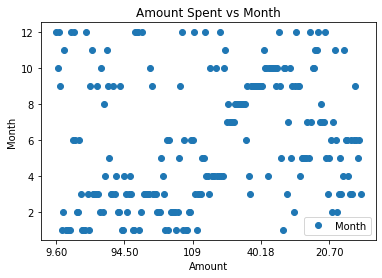

In [217]:
dataF =pd.read_csv('/home/jovyan/Elie_Code/instructions_nws/CroppedImages/df.csv')

final_dataframeInner_copy_nonnull.plot(x='Amount', y='Month', style='o')
plt.title('Amount Spent vs Month')
plt.xlabel('Amount')
plt.ylabel('Month')
plt.show()

    Amount          FileName        Date Month Category
0     9.60  X00016469612.jpg  25/12/2018    12        0
1    60.31  X00016469619.jpg  19/10/2018    10        1
2    33.90  X00016469620.jpg    12-01-19    12        0
3    31.00  X00016469669.jpg  09/01/2019     9        0
4      193  X00016469670.jpg  15/01/2019     1        1
..     ...               ...         ...   ...      ...
276  59.00  X51008164969.jpg    21:22:27     9        1
277  35.00  X51008164991.jpg  13-06-2018     6        0
278  87.45  X51008164992.jpg  30-05-2018     5        1
279  38.00  X51008164998.jpg  20-06-2018     6        0
280   0.90  X51009447842.jpg  14/03/2018     3        0

[224 rows x 5 columns]


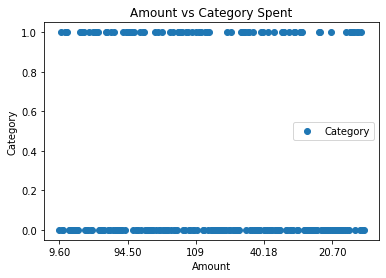

In [216]:
# Adding Category column to seperate expenses.

final_dataframeInner_copy_nonnull['Category'] = None
for index, row in final_dataframeInner_copy_nonnull.iterrows():
    try:
        if float(row['Amount']) > 50: 
            row['Category'] = float(1)
        else :
            row['Category'] = float(0)    
    except:
        pass

print(final_dataframeInner_copy_nonnull)

final_dataframeInner_copy_nonnull.plot(x='Amount', y='Category', style='o')
plt.title('Amount vs Category Spent')
plt.xlabel('Amount')
plt.ylabel('Category')
plt.show()



## Machine Learning with different Algorithms
## Split Data:

In [208]:
from sklearn.model_selection import train_test_split

final_dataframeInner_copy_nonnull = final_dataframeInner_copy_nonnull[final_dataframeInner_copy_nonnull['Category'].notnull()]
print(final_dataframeInner_copy_nonnull)                                                     

sdf = final_dataframeInner_copy_nonnull[['Amount', 'Category']].copy()
print(sdf)
X = sdf.iloc[:,0].values
y = sdf.iloc[:,-1].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

print('X_train=', X_train, '\n', 'y_train=', y_train)
print(len(X_train) ==  len(y_train))

    Amount          FileName        Date Month Category
0     9.60  X00016469612.jpg  25/12/2018    12        0
1    60.31  X00016469619.jpg  19/10/2018    10        1
2    33.90  X00016469620.jpg    12-01-19    12        0
3    31.00  X00016469669.jpg  09/01/2019     9        0
4      193  X00016469670.jpg  15/01/2019     1        1
..     ...               ...         ...   ...      ...
276  59.00  X51008164969.jpg    21:22:27     9        1
277  35.00  X51008164991.jpg  13-06-2018     6        0
278  87.45  X51008164992.jpg  30-05-2018     5        1
279  38.00  X51008164998.jpg  20-06-2018     6        0
280   0.90  X51009447842.jpg  14/03/2018     3        0

[224 rows x 5 columns]
    Amount Category
0     9.60        0
1    60.31        1
2    33.90        0
3    31.00        0
4      193        1
..     ...      ...
276  59.00        1
277  35.00        0
278  87.45        1
279  38.00        0
280   0.90        0

[224 rows x 2 columns]
X_train= ['23.26' '26.80' '5.00' '20.70'

# Linear Regression, Gradient Boost Regressor, Logistic Regression, KMeans:

  Actual  Predicted
0      0   0.364030
1      0   0.364002
2      0   0.363943
3      1   0.364096
4      0   0.363956
Mean Absolute Error: for Linear Regressor 0.4424923511306155
Mean Squared Error: for Linear Regressor 0.2109624619458184
Root Mean Squared Error: for Linear Regressor 0.4593065010924823


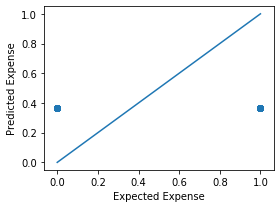

In [209]:
# Implement the Linear regression and try to find out 

regressor = LinearRegression()
regressor.fit(X_train.reshape(-1,1), y_train)

y_pred = regressor.predict(X_test.reshape(-1, 1))

ddf = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
print(ddf.head(5))
plt.figure(figsize=(4, 3))
plt.scatter(y_test, y_pred)
plt.plot([0,1], [0, 1])
plt.axis('tight')
plt.xlabel('Expected Expense')
plt.ylabel('Predicted Expense')
plt.tight_layout()

print('Mean Absolute Error: for Linear Regressor', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error: for Linear Regressor', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error: for Linear Regressor', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))


#Learning Linear Regression is not working out very well.

Mean Absolute Error: for Gradient Boost Regressor 0.4424923511306155
Mean Squared Error: for Gradient Boost Regressor 0.2109624619458184
Root Mean Squared Error: for Gradient Boost Regressor 0.4593065010924823


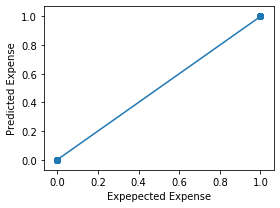

In [202]:
# Matrics to measure different type of scores which shows the accuracy of the models.

# Gradient Boost Regressor

clf = GradientBoostingRegressor()
clf.fit(X_train.reshape(-1,1), y_train)
predicted = clf.predict(X_test.reshape(-1,1))
expected = y_test

plt.figure(figsize=(4, 3))
plt.scatter(expected, predicted)
plt.plot([0, 1], [0, 1])
plt.axis('tight')
plt.xlabel('Expepected Expense')
plt.ylabel('Predicted Expense')
plt.tight_layout()

print('Mean Absolute Error: for Gradient Boost Regressor', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error: for Gradient Boost Regressor', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error: for Gradient Boost Regressor', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))


X_train=     Amount Category
36   23.26        0
179  26.80        0
247   5.00        0
251  20.70        0
167  59.31        1
..     ...      ...
81    2.30        0
243   8.70        0
137  14.63        0
53   56.80        1
218  87.19        1

[179 rows x 2 columns] 
 y_train= <class 'pandas.core.series.Series'>
True


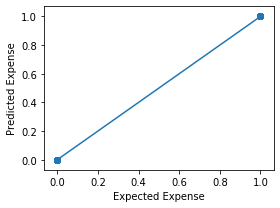

In [211]:
#Working with Logistic Regression
sdf = final_dataframeInner_copy_nonnull[['Amount', 'Category']].copy()

y = sdf.iloc[:,-1]
X = sdf.iloc[:,:2]

X_train,X_test,y_train,y_test = train_test_split(X,y, test_size=0.2, random_state=0)

print('X_train=', X_train, '\n', 'y_train=', type(y_train))
print(len(X_train) ==  len(y_train))

LR = LogisticRegression(random_state=0, solver='lbfgs', multi_class='ovr').fit(X_train,y_train.astype('int'))
y_pred = LR.predict(X_test)
plt.figure(figsize=(4, 3))
plt.scatter(y_test, y_pred)
plt.plot([0,1], [0, 1])
plt.axis('tight')
plt.xlabel('Expected Expense')
plt.ylabel('Predicted Expense')
plt.tight_layout()

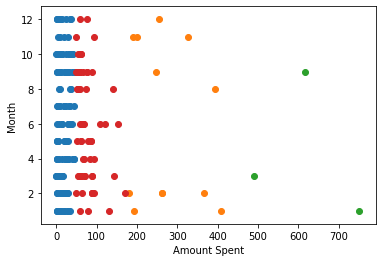

In [213]:
# Let's implement k-means clustering for a use case of finding how much money an employee/ unit spent on a given month.
# We could have used so many different factors to the count to implement a better accuracy level for the clusters
# but we don't have enough features to make it more accurate. But we tried. 

sdf = final_dataframeInner_copy_nonnull[['Amount','Month']].copy()
sdf['Amount'] = sdf['Amount'].astype(float)
sdf = sdf.sort_values(by=['Amount'])[:-6]

sdf = sdf.to_numpy()

# Define the model to classify our expenses in 4 different clusters
# 1. Blue color represents Manager approval is sufficient
# 2. Green color represents Senior Manager needs  to approve it.
# 3. Red color represents VP needs to take an action
# 4. Orange color represents EVP needs to take an action.
model = KMeans(n_clusters=4)
# fit the model
model.fit(sdf)
# Categorise based on the clusters. 
ypred = model.predict(sdf)
# Find 4 Unique clusters.
clusters = unique(ypred)

#Plot the data.
for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(ypred == cluster)
    # create scatter of these samples
    plt.scatter(sdf[row_ix, 0], sdf[row_ix, 1])
    plt.xlabel('Amount Spent')
    plt.ylabel('Month')
# show the plot
plt.show()